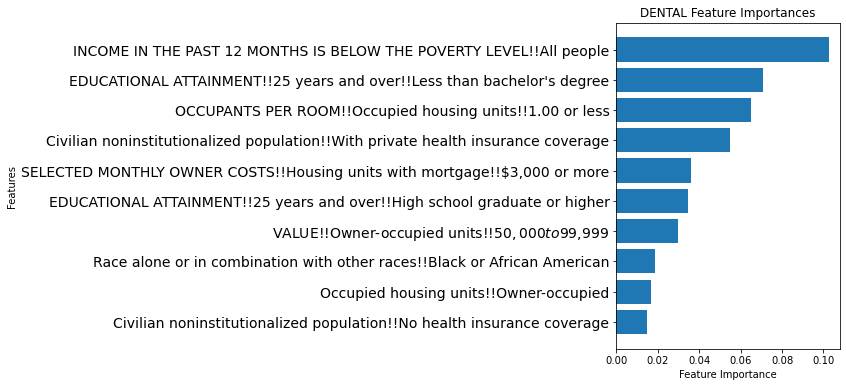

In [13]:
import matplotlib.pyplot as plt

updated_sorted_feature_names = ['Civilian noninstitutionalized population!!No health insurance coverage', 'Occupied housing units!!Owner-occupied', 'Race alone or in combination with other races!!Black or African American', 'VALUE!!Owner-occupied units!!$50,000 to $99,999', 'EDUCATIONAL ATTAINMENT!!25 years and over!!High school graduate or higher', 'SELECTED MONTHLY OWNER COSTS!!Housing units with mortgage!!$3,000 or more', 'Civilian noninstitutionalized population!!With private health insurance coverage', 'OCCUPANTS PER ROOM!!Occupied housing units!!1.00 or less', "EDUCATIONAL ATTAINMENT!!25 years and over!!Less than bachelor's degree", "INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!All people"]
sorted_feature_importances = [0.014553472987872152, 0.016758544652701258, 0.018743109151047467, 0.02991547225284825, 0.034325615582506463, 0.03579566335905922, 0.055053289231900074, 0.06512311650128635, 0.07063579566335912, 0.1026828371922088]

# Plot feature importances
plt.figure(figsize=(4, 6))
plt.barh(range(len(sorted_feature_importances)), sorted_feature_importances)
plt.yticks(range(len(sorted_feature_importances)), updated_sorted_feature_names, fontsize=14)
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title(f'DENTAL Feature Importances')
plt.show()

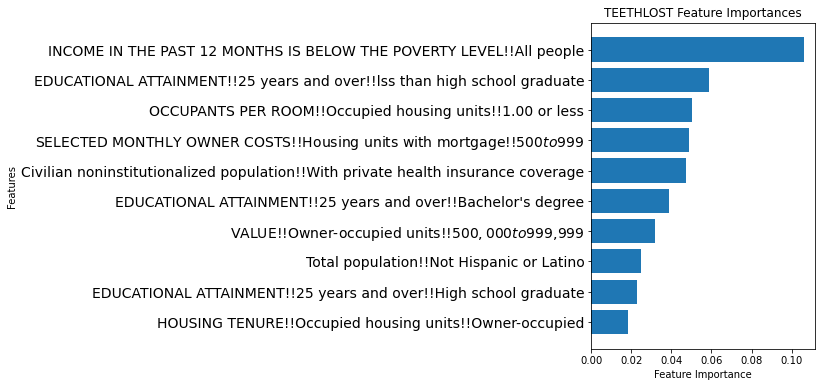

In [15]:
updated_sorted_feature_names = ['HOUSING TENURE!!Occupied housing units!!Owner-occupied', 'EDUCATIONAL ATTAINMENT!!25 years and over!!High school graduate', 'Total population!!Not Hispanic or Latino', 'VALUE!!Owner-occupied units!!$500,000 to $999,999', "EDUCATIONAL ATTAINMENT!!25 years and over!!Bachelor's degree", 'Civilian noninstitutionalized population!!With private health insurance coverage', 'SELECTED MONTHLY OWNER COSTS!!Housing units with mortgage!!$500 to $999', 'OCCUPANTS PER ROOM!!Occupied housing units!!1.00 or less', 'EDUCATIONAL ATTAINMENT!!25 years and over!!lss than high school graduate', 'INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!All people']
sorted_feature_importances = [0.01812154696132595, 0.022762430939226475, 0.024972375690607708, 0.031675874769797364, 0.03882136279926331, 0.04729281767955797, 0.04883977900552483, 0.05016574585635356, 0.058784530386740294, 0.10615101289134436]

# Plot feature importances
plt.figure(figsize=(4, 6))
plt.barh(range(len(sorted_feature_importances)), sorted_feature_importances)
plt.yticks(range(len(sorted_feature_importances)), updated_sorted_feature_names, fontsize=14)
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title(f'TEETHLOST Feature Importances')
plt.show()

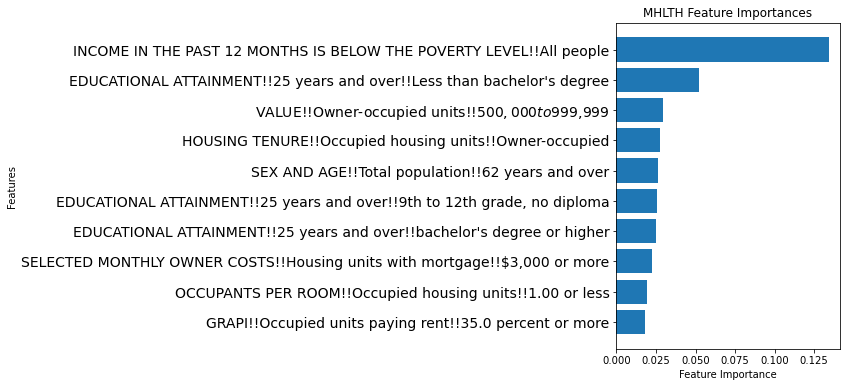

In [19]:
updated_sorted_feature_names = ['GRAPI!!Occupied units paying rent!!35.0 percent or more', 'OCCUPANTS PER ROOM!!Occupied housing units!!1.00 or less', 'SELECTED MONTHLY OWNER COSTS!!Housing units with mortgage!!$3,000 or more', "EDUCATIONAL ATTAINMENT!!25 years and over!!bachelor's degree or higher", 'EDUCATIONAL ATTAINMENT!!25 years and over!!9th to 12th grade, no diploma', 'SEX AND AGE!!Total population!!62 years and over', 'HOUSING TENURE!!Occupied housing units!!Owner-occupied', 'VALUE!!Owner-occupied units!!$500,000 to $999,999', "EDUCATIONAL ATTAINMENT!!25 years and over!!Less than bachelor's degree", 'INCOME IN THE PAST 12 MONTHS IS BELOW THE POVERTY LEVEL!!All people']
sorted_feature_importances = [0.01830209481808156, 0.019404630650496114, 0.02271223814773977, 0.02513781697905182, 0.025725836089672917, 0.02601984564498343, 0.02771040058801908, 0.029327453142227088, 0.05203969128996688, 0.1343623667769202]
# Plot feature importances
plt.figure(figsize=(4, 6))
plt.barh(range(len(sorted_feature_importances)), sorted_feature_importances)
plt.yticks(range(len(sorted_feature_importances)), updated_sorted_feature_names, fontsize=14)
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title(f'MHLTH Feature Importances')
plt.show()

In [3]:
print(len(merge_all_data.columns))

# columns_to_remove = [col for col in merge_all_data.columns if col.endswith('s')]
# # columns_to_remove = columns_to_remove + [col for col in merge_all_data.columns if col.endswith('y')]
# columns_to_remove = columns_to_remove + [col for col in merge_all_data.columns if col.endswith('e') and col != 'Data_Value']

ARTH_TRAIN = merge_all_data#.drop(columns=columns_to_remove)                                     

print(len(ARTH_TRAIN.columns))

484
484


In [13]:
corr_matrix = ARTH_TRAIN.corr()

In [14]:
upper_triangle = np.triu(np.ones_like(corr_matrix, dtype=bool), k=1)
upper_triangle = corr_matrix.where(upper_triangle)
upper_triangle.to_csv('upper_correlation_matrix.csv', index=True, header=True)
corr_matrix.to_csv('correlation_matrix.csv', index=True, header=True)


# Ensemble Method

In [6]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.ensemble import HistGradientBoostingClassifier as ensemble
from sklearn.preprocessing import StandardScaler
from sklearn.inspection import permutation_importance
import matplotlib.pyplot as plt
import joblib
from sklearn.metrics import classification_report
import shap

measure_id_set = set(ct_500_cities['MeasureId']) - {'MAMMOUSE', 'PAPTEST', 'BINGE', 'HIGHCHOL', 'COREM', 'BPHIGH', 'CHOLSCREEN', 'BPMED', 'CASTHMA', 'COREW', 'ARTHRITIS', 'PHLTH'}

for measure in measure_id_set:

  # Get data for only the selected measure, and drop any census tracts where there is a NaN Data_Value for that meausre.
  merge_data_measure = ARTH_TRAIN[merge_all_data['MeasureId'] == measure].dropna(subset=['Data_Value'])
  merge_data_measure = merge_data_measure.reset_index(drop=True)
  scaler = StandardScaler()

  y = merge_data_measure['Data_Value']

  least_important = ['start']
  feature_count = len(ARTH_TRAIN.columns) - 1
  
  if measure == 'ACCESS2': # Remove health insurance coverage features since that is what we're predicting with the measure
     merge_data_measure = merge_data_measure.drop(columns=['Percent Estimate!!HEALTH INSURANCE COVERAGE!!Civilian noninstitutionalized population!!No health insurance coverage', 'Percent Estimate!!HEALTH INSURANCE COVERAGE!!Civilian noninstitutionalized population!!Civilian noninstitutionalized population 19 to 64 years!!Not in labor force!!No health insurance coverage',
                                                           'Percent Estimate!!HEALTH INSURANCE COVERAGE!!Civilian noninstitutionalized population!!Civilian noninstitutionalized population 19 to 64 years!!In labor force!!Unemployed!!No health insurance coverage', 'Percent Estimate!!HEALTH INSURANCE COVERAGE!!Civilian noninstitutionalized population!!Civilian noninstitutionalized population under 19 years!!No health insurance coverage'])

  print(f"\n\nBegin Outcome: {measure}")

  # while len(least_important) >= 1 and ((feature_count - len(least_important)) >= 10 or np.mean(test_scores) > 0.7):
  while feature_count > 10:
    print(f"Outcome: {measure}")

    # Recursive Feature Elimination - Drop the features that were the least important from the previous iteration
    if least_important[0] != 'start':
      merge_data_measure = merge_data_measure.drop(columns=least_important)
    
    

    # Commenting this out since Gina doesn't need it right now.
    # print("Updating FIPS codes to retain State and County Level only. This should take about ~3 minutes.")
    # merge_data_measure['FIPS'] = merge_data_measure['FIPS'].values.astype(str)
    # for row in merge_data_measure['FIPS']:
    #   merge_data_measure.replace(row, row[:5], inplace = True)
    # FIPS = merge_data_measure['FIPS'].copy()
    # print("FIPS Update complete.")

    # Keep only the numeric features. Drop data_value column since that will be the predicted variable.
    X_numeric = merge_data_measure.select_dtypes(include='number').drop(columns=['Data_Value'])
    # Scale the features
    X_numeric_scaled = scaler.fit_transform(X_numeric)

    # Create 3 bins for the outcomes data. All 3 will be of equal size. The cutoff for each quantile is different for each measure.
    y_binned = pd.qcut(y, q=3, labels=False)

    feature_count = len(X_numeric.columns)
    print("new feature_count", feature_count)

    N_SPLITS = 10
    SKF = StratifiedKFold(n_splits=N_SPLITS, shuffle=True)

    SKF.get_n_splits(X = X_numeric_scaled, y = y_binned)

    # Instructor says max depth 1-5 for random forests
    # StatQuest says max_leaf_nodes is usually 8-32
    # parameters = {'class_weight': [None], 'early_stopping': ['auto'], 'interaction_cst': [None], 'l2_regularization': [0.0], 'learning_rate': [0.1],
    #               'loss': ['log_loss'],'max_bins': [10, 20, 100], 'max_depth': [5], 'max_iter': [25, 50, 100], 'max_leaf_nodes': [8, 16, 32],
    #               'min_samples_leaf': [10, 100, 500], 'monotonic_cst': [None], 'n_iter_no_change': [10], 'random_state': [None], 'scoring': ['loss'],
    #               'tol': [1e-07], 'validation_fraction': [0.1], 'verbose': [0], 'warm_start': [False]}
    parameters = {'class_weight': [None], 'early_stopping': ['auto'], 'interaction_cst': [None], 'l2_regularization': [0.0], 'learning_rate': [0.1], 'loss': ['log_loss'],'max_bins': [10],
                  'max_depth': [5], 'max_iter': [100], 'max_leaf_nodes': [16], 'min_samples_leaf': [100], 'monotonic_cst': [None], 'n_iter_no_change': [10], 'random_state': [None],
                  'scoring': ['loss'], 'tol': [1e-07], 'validation_fraction': [0.1], 'verbose': [0], 'warm_start': [False]}

    param_combo_scores = {}
    param_combo_times = {}
    test_scores = []
    train_scores = []

    scoring = 'accuracy'

    # Initiate a Ensemble classifier
    clf = ensemble()

    current_best = 0
    print("Beginning Model Training\n\n")

    for index, (train_index, test_index) in enumerate(SKF.split(X = X_numeric_scaled, y = y_binned)):
        x_train = np.take(X_numeric_scaled, train_index, 0)
        y_train = np.take(y_binned, train_index, 0)

        x_test = np.take(X_numeric_scaled, test_index, 0)
        y_test = np.take(y_binned, test_index, 0)

        grid = GridSearchCV(clf, param_grid = parameters, scoring = scoring)
        grid.fit(X = x_train, y = y_train)
        test_score = grid.score(X = x_test, y = y_test)

        for params, score, time in zip(grid.cv_results_['params'], grid.cv_results_['mean_test_score'], grid.cv_results_['mean_fit_time']):
          param_str = str(params)
          if param_str not in param_combo_scores:
              param_combo_scores[param_str] = []
              param_combo_times[param_str] = []
          param_combo_scores[param_str].append(score)
          param_combo_times[param_str].append(time)

        test_scores.append(test_score)
        train_scores.append(grid.best_score_)

        print(f"End of Split: {index + 1}")
        
    print(f"Average Train Score: {np.mean(train_scores)}, Average Test Score: {np.mean(test_scores)}")

    # # Compute average score and time for each parameter combination
    # avg_scores = {param: np.mean(scores) for param, scores in param_combo_scores.items()}
    # avg_times = {param: np.mean(times) for param, times in param_combo_times.items()}

    # # Print average scores and times for each parameter combination
    # for param, avg_score in avg_scores.items():
    #     avg_time = avg_times[param]
    #     print(f"Parameter Combo: {param}, Average Score: {avg_score}, Average Time: {avg_time}")
    # break
    # print("Classification Report:", classification_report(y_test, y_pred))
    joblib.dump(grid, f"Models\{measure}_model_{feature_count}.pkl")

  
    feature_importances = permutation_importance(grid.best_estimator_, x_test, y_test)
    feature_importances_index = feature_importances.importances_mean.argsort()

    least_important = []

    distinct_importances = list(set(abs(feature_importances.importances_mean)))

    remove_value = 0

    while (len(least_important) < feature_count*0.2 and (feature_count - len(least_important)) > 30) or len(least_important) == 0:
      for i in feature_importances_index:
          if abs(feature_importances.importances_mean[i]) == remove_value:
              least_important.append(X_numeric.columns[i])
      if remove_value in distinct_importances:
        distinct_importances.remove(remove_value)
      if -remove_value in distinct_importances:
        distinct_importances.remove(-remove_value)
      if len(distinct_importances) > 0:
        remove_value = abs(min(distinct_importances))


    print(f"Outcome: {measure}")
    print(f"Test Score: {np.mean(test_scores)}")
    print(f"Train Score: {np.mean(train_scores)}")
    print("Top Permutation Feature Importances:")
    for i in feature_importances_index:
      print(f"{X_numeric.columns[i]}: {feature_importances.importances_mean[i]}")
  
  # break
  print(f"Outcome: {measure}")
  print("\nFinal Permutation Feature Importances:")
  # print(feature_importances.importances_mean)
  for i in feature_importances_index:
    print(f"{X_numeric.columns[i]}: {feature_importances.importances_mean[i]}")
                                   



Begin Outcome: SLEEP
Outcome: SLEEP
new feature_count 481
Beginning Model Training


End of Split: 1
End of Split: 2
End of Split: 3
End of Split: 4
End of Split: 5
End of Split: 6
End of Split: 7
End of Split: 8
End of Split: 9
End of Split: 10
Average Train Score: 0.6700107856803188, Average Test Score: 0.7991179713340684
Outcome: SLEEP
Test Score: 0.7991179713340684
Train Score: 0.6700107856803188
Top Permutation Feature Importances:
Percent Estimate!!EDUCATIONAL ATTAINMENT!!Population 25 years and over!!Percent less than high school graduate: -0.00286659316427782
Percent Estimate!!SELECTED MONTHLY OWNER COSTS AS A PERCENTAGE OF HOUSEHOLD INCOME (SMOCAPI)!!Housing unit without a mortgage (excluding units where SMOCAPI cannot be computed)!!10.0 to 14.9 percent: -0.002499081220139643
Percent Estimate!!ANCESTRY!!Total population!!American: -0.002425578831311981
Percent Estimate!!EDUCATIONAL ATTAINMENT!!Population 25 years and over!!Percent bachelor's degree or higher: -0.002058066887

In [11]:
# Stroke
max_bins_20_score = []
max_bins_20_time = []

for param, avg_score in avg_scores.items():
    avg_time = avg_times[param]
    print(f"Parameter Combo: {param}, Average Score: {avg_score}, Average Time: {avg_time}")
    param_dict = eval(param)
    if param_dict['max_bins'] == 20:
        max_bins_20_score.append()



Parameter Combo: {'class_weight': None, 'early_stopping': 'auto', 'interaction_cst': None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss': 'log_loss', 'max_bins': 20, 'max_depth': 5, 'max_iter': 50, 'max_leaf_nodes': 8, 'min_samples_leaf': 10, 'monotonic_cst': None, 'n_iter_no_change': 10, 'random_state': None, 'scoring': 'loss', 'tol': 1e-07, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}, Average Score: 0.7312085173437659, Average Time: 3.958609046936035
Parameter Combo: {'class_weight': None, 'early_stopping': 'auto', 'interaction_cst': None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss': 'log_loss', 'max_bins': 20, 'max_depth': 5, 'max_iter': 50, 'max_leaf_nodes': 8, 'min_samples_leaf': 100, 'monotonic_cst': None, 'n_iter_no_change': 10, 'random_state': None, 'scoring': 'loss', 'tol': 1e-07, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}, Average Score: 0.731996718351491, Average Time: 3.971506271362305
Parameter Combo: {'class_weigh

# Visualization

In [22]:
print(test['rank_test_score'].dtype == 'object')

False


In [5]:
#Determine Prediction Values
label = grid.best_estimator_.predict(X_numeric)

#Add predictions values to dataset
ARTH_TRAIN.loc[:, "label"] = list(label)

import numpy as np
import pandas as pd
try:
    import geopandas as gpd
except:
    print("geopandas package not available. Installing package.")
    %pip install geopandas
    import geopandas
try:
    import requests
except:
    print("requests package not available. Installing package.")
    %pip install requests
    import requests

%pip install folium
%pip install matplotlib
%pip install mapclassify

import geopandas

county_shp = geopandas.read_file('Data/cb_2022_us_county_500k.zip')
ky_counties = county_shp[county_shp.STATE_NAME == 'Florida']
ky_counties['FIPS'] = ky_counties['STATEFP'] + ky_counties['COUNTYFP']

df_map = (ky_counties.merge(ARTH_TRAIN, how = 'left', on = 'FIPS')
                     .rename(columns = {'NAME' : 'County Name',
                                        'label' : 'Risk',
                                        'Data_Value' : 'Percentage With High Cholesterol (%)',
                                        'E_TOTPOP' : 'County Population'}))

df_map.explore(
    column = 'Risk',
    tooltip = ['County Name', 'Risk', 'Percentage With High Cholesterol (%)', 'County Population'],
    tiles = 'CartoDB positron', #fades into the background better than the default
    style_kwds=dict(color="black") #outlines stay black for a crisper feel
)

c:\Users\alexk\AppData\Local\Programs\Python\Python39\lib\site-packages\sklearn\base.py:486: UserWarning: X has feature names, but HistGradientBoostingClassifier was fitted without feature names
  warnings.warn(


You should consider upgrading via the 'c:\Users\alexk\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.


Note: you may need to restart the kernel to use updated packages.


You should consider upgrading via the 'c:\Users\alexk\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.
You should consider upgrading via the 'c:\Users\alexk\AppData\Local\Programs\Python\Python39\python.exe -m pip install --upgrade pip' command.


Note: you may need to restart the kernel to use updated packages.


c:\Users\alexk\AppData\Local\Programs\Python\Python39\lib\site-packages\geopandas\geodataframe.py:1525: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)
